## Import Libraries

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.figure_factory as ff
import seaborn as sns

dataset1 = pd.read_excel("dataset one.xlsx")
dataset2 = pd.read_excel("dataset two.xlsx")
dataset1

,DATES,MAX TEMP (0C),MIN TEMP (0C),RAIN (mm),RH% 0600Z,RH% 0900Z,RH% 1200Z,RH% 1500Z
0,2010-01-01,32.5,24.5,0.0,97.0,88.0,61.0,52.0
1,2010-01-02,34,23.7,0.0,97.0,81.0,55.0,40.0
2,2010-01-03,33.2,23.8,0.0,96.0,88.0,58.0,42.0
3,2010-01-04,32.1,24.1,0.0,99.0,88.0,61.0,49.0
4,2010-01-05,32.5,24.3,0.0,98.0,84.0,58.0,47.0
...,...,...,...,...,...,...,...,...
2917,2017-12-27,NaN,NaN,0.0,90.0,69.0,59.0,46.0
2918,2017-12-28,32.2,NaN,0.0,97.0,77.0,58.0,58.0
2919,2017-12-29,32,NaN,0.0,96.0,84.0,58.0,61.0
2920,2017-12-30,31.8,NaN,0.0,NaN,85.0,62.0,46.0


In [ ]:
dataset2

,DATES,MAX TEMP (0C),MIN TEMP (0C),RAIN (mm),RH% 0600Z,RH% 0900Z,RH% 1200Z,RH% 1500Z
0,2010-01-01,32.5,24.5,0.0,97.0,88.0,61.0,52.0
1,2010-01-02,34,23.7,0.0,97.0,81.0,55.0,40.0
2,2010-01-03,33.2,23.8,0.0,96.0,88.0,58.0,42.0
3,2010-01-04,32.1,24.1,0.0,99.0,88.0,61.0,49.0
4,2010-01-05,32.5,24.3,0.0,98.0,84.0,58.0,47.0
...,...,...,...,...,...,...,...,...
2917,2017-12-27,NaN,NaN,0.0,90.0,69.0,59.0,46.0
2918,2017-12-28,32.2,NaN,0.0,97.0,77.0,58.0,58.0
2919,2017-12-29,32,NaN,0.0,96.0,84.0,58.0,61.0
2920,2017-12-30,31.8,NaN,0.0,NaN,85.0,62.0,46.0


In [ ]:
# Merge the datasets


In [ ]:
# Set the date column as index
dataset.set_index('DATES', inplace=True)
dataset

,MAX TEMP (0C),MIN TEMP (0C),RAIN (mm),RH%,RH%.1,RH%.2,RH%.3
DATES,,,,,,,
NaT,NaN,NaN,NaN,0600Z,0900Z,1200Z,1500Z
2010-01-01,32.5,24.5,0,97,88,61,52
2010-01-02,34,23.7,0,97,81,55,40
2010-01-03,33.2,23.8,0,96,88,58,42
2010-01-04,32.1,24.1,0,99,88,61,49
...,...,...,...,...,...,...,...
2017-12-27,-,-,0,90,69,59,46
2017-12-28,32.2,-,0,97,77,58,58
2017-12-29,32,-,0,96,84,58,61


In [ ]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 2923 entries, NaT to 2017-12-31
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   MAX TEMP (0C)   2920 non-null   object
 1   MIN TEMP  (0C)  2919 non-null   object
 2   RAIN (mm)       2921 non-null   object
 3   RH%             2923 non-null   object
 4   RH%.1           2923 non-null   object
 5   RH%.2           2922 non-null   object
 6   RH%.3           2923 non-null   object
dtypes: object(7)
memory usage: 182.7+ KB


In [ ]:
dataset.describe()

,MAX TEMP (0C),MIN TEMP (0C),RAIN (mm),RH%,RH%.1,RH%.2,RH%.3
count,2920,2919.0,2921,2923,2923,2922,2923
unique,133,103.0,549,56,73,77,78
top,32,23.5,0,96,85,78,72
freq,89,228.0,1385,919,218,114,105


In [ ]:
# Function to plot interactive plots using Plotly Express
def interactive_plot(df, column, timestamp, title):
  '''
  df: dataframe, the dataset.
  column: str, name of column you want to plot
  title: str, title of the plot
  timestamp: str, column of the time for the time series data
  '''
  fig = px.line(title=title)
  for i in df[[column]]:
    fig.add_scatter(x=timestamp, y=df[i], name=i)
  fig.show()
              
interactive_plot(dataset, 'PS', dataset.index, 'Surface Pressure Data')       

In [ ]:
dataset['Next PS'] = dataset[['PS']].shift(-1)
dataset

,T2M,T2MDEW,T2MWET,QV2M,RH2M,PRECTOTCORR,PS,WS10M,WD10M,Next PS
Date,,,,,,,,,,
2010-01-01 00:00:00,24.37,21.81,23.09,16.30,85.56,0.0,100.66,1.79,240.97,100.62
2010-01-01 01:00:00,24.14,21.77,22.95,16.30,86.56,0.0,100.62,1.65,243.92,100.58
2010-01-01 02:00:00,23.99,21.75,22.87,16.24,87.19,0.0,100.58,1.47,250.12,100.58
2010-01-01 03:00:00,23.87,21.80,22.83,16.30,88.12,0.0,100.58,1.31,255.88,100.60
2010-01-01 04:00:00,23.74,21.85,22.80,16.36,89.12,0.0,100.60,1.19,263.58,100.62
...,...,...,...,...,...,...,...,...,...,...
2017-12-31 19:00:00,25.40,20.30,22.85,14.83,73.25,0.0,100.65,1.75,298.86,100.73
2017-12-31 20:00:00,25.11,19.84,22.48,14.40,72.56,0.0,100.73,1.73,295.75,100.78
2017-12-31 21:00:00,24.87,19.41,22.14,14.04,71.62,0.0,100.78,1.66,296.93,100.78


In [ ]:
# Remove last nan row
dataset = dataset[:-1]
dataset

,T2M,T2MDEW,T2MWET,QV2M,RH2M,PRECTOTCORR,PS,WS10M,WD10M,Next PS
Date,,,,,,,,,,
2010-01-01 00:00:00,24.37,21.81,23.09,16.30,85.56,0.0,100.66,1.79,240.97,100.62
2010-01-01 01:00:00,24.14,21.77,22.95,16.30,86.56,0.0,100.62,1.65,243.92,100.58
2010-01-01 02:00:00,23.99,21.75,22.87,16.24,87.19,0.0,100.58,1.47,250.12,100.58
2010-01-01 03:00:00,23.87,21.80,22.83,16.30,88.12,0.0,100.58,1.31,255.88,100.60
2010-01-01 04:00:00,23.74,21.85,22.80,16.36,89.12,0.0,100.60,1.19,263.58,100.62
...,...,...,...,...,...,...,...,...,...,...
2017-12-31 18:00:00,26.12,20.96,23.54,15.50,73.25,0.0,100.58,1.58,306.36,100.65
2017-12-31 19:00:00,25.40,20.30,22.85,14.83,73.25,0.0,100.65,1.75,298.86,100.73
2017-12-31 20:00:00,25.11,19.84,22.48,14.40,72.56,0.0,100.73,1.73,295.75,100.78


## Exploratory Data Analysis



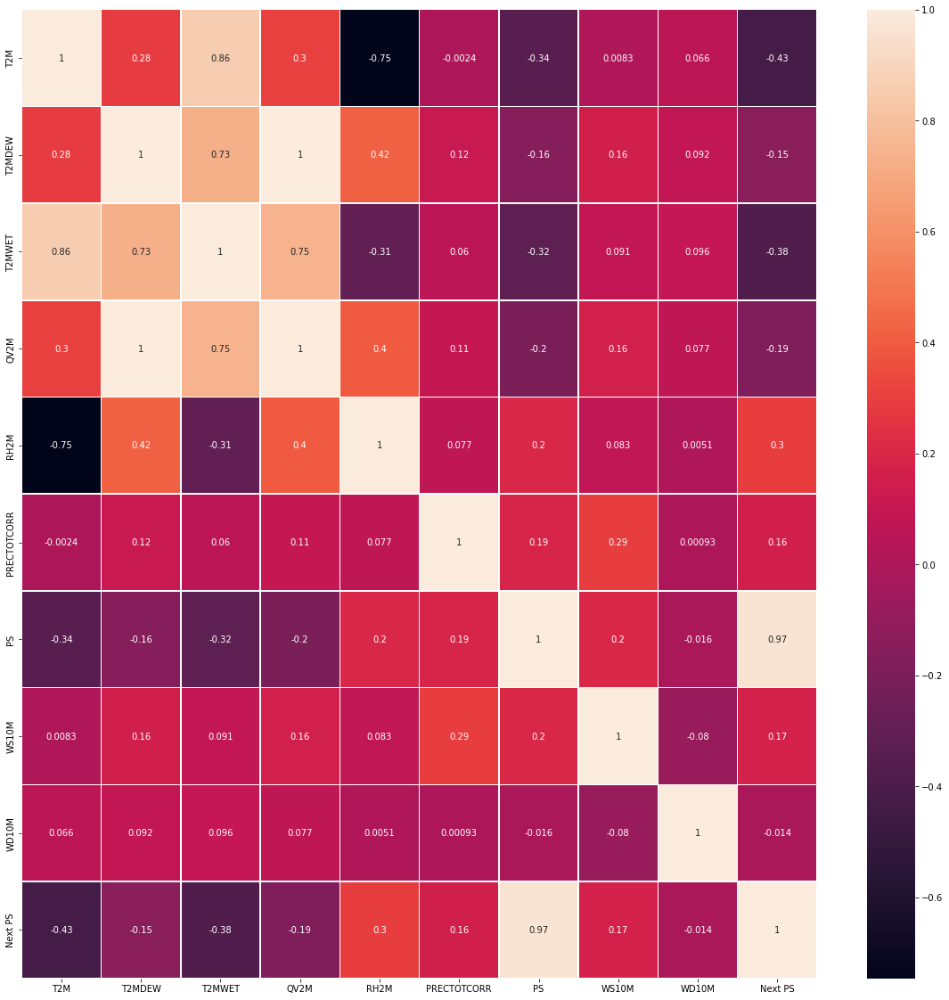

In [ ]:
# Pearson's Corrrelation Plot with Seaborn
fig, ax = plt.subplots(figsize=(20,20))  # Sample figsize in inches
sns.heatmap(dataset.corr(method='pearson'), annot=True, linewidths=.5, ax=ax)

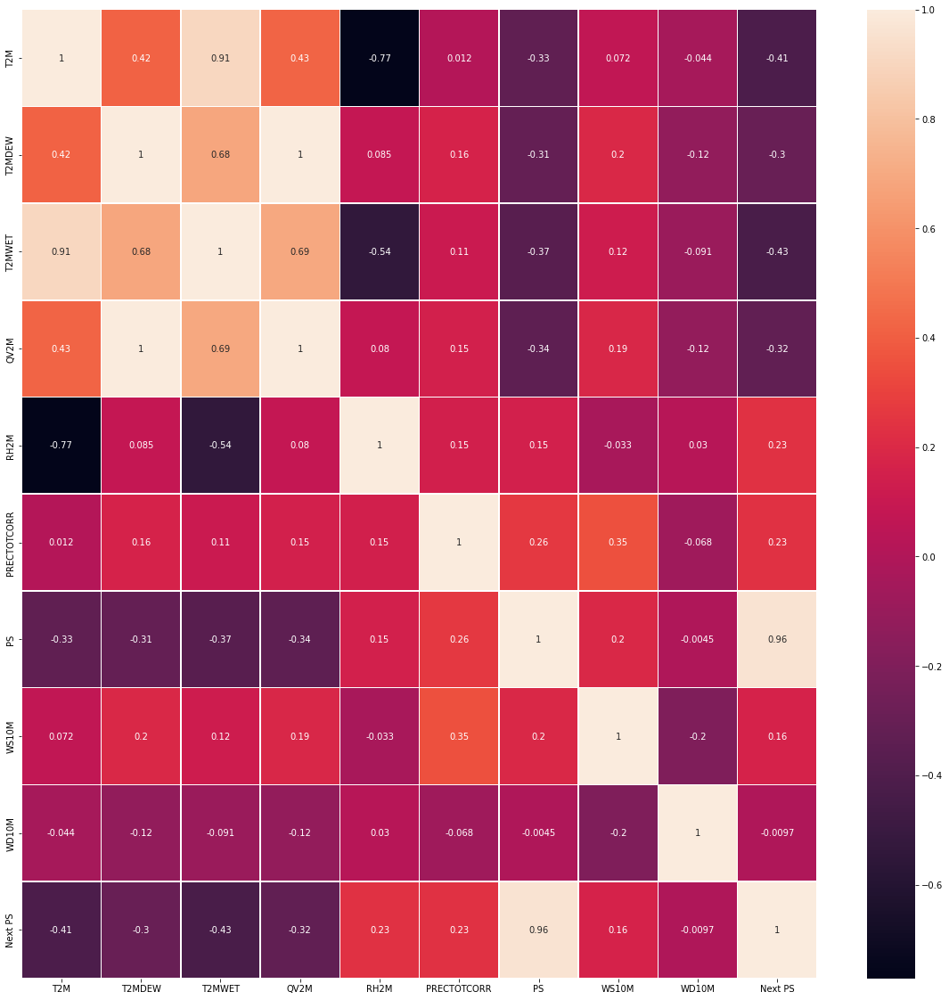

In [ ]:
# Pearson's Corrrelation Plot with Seaborn
fig, ax = plt.subplots(figsize=(20,20))  # Sample figsize in inches
sns.heatmap(dataset.corr(method='spearman'), annot=True, linewidths=.5, ax=ax)

There is a high positive correlation between the PS and Next PS.

#### Visualization to see which features correlate with the future Relative Humidity

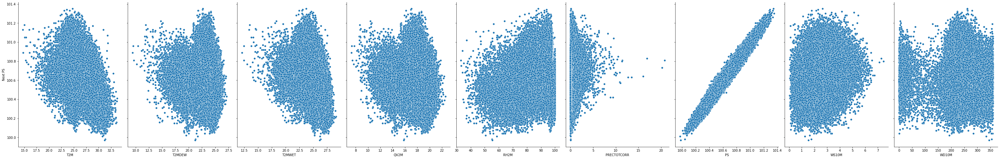

In [ ]:
sns.pairplot(dataset, x_vars=["T2M", "T2MDEW", "T2MWET", "QV2M", "RH2M", "PRECTOTCORR", "PS", "WS10M", "WD10M"],
             y_vars=["Next PS"], height=7, aspect=0.7)

## Create Model to Predict Future Surface Pressure

In [ ]:
ps_data = dataset[["PS", "Next PS"]]
ps_data

,PS,Next PS
Date,,
2010-01-01 00:00:00,100.66,100.62
2010-01-01 01:00:00,100.62,100.58
2010-01-01 02:00:00,100.58,100.58
2010-01-01 03:00:00,100.58,100.60
2010-01-01 04:00:00,100.60,100.62
...,...,...
2017-12-31 18:00:00,100.58,100.65
2017-12-31 19:00:00,100.65,100.73
2017-12-31 20:00:00,100.73,100.78


### Standardize the Data

In [ ]:
# Feature Scaling
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
scaled_ps_data = scaler.fit_transform(ps_data)

print("Mean of each column", scaler.mean_)
print("Variance of each column", scaler.var_)
scaled_ps_data

Mean of each column [100.65188045 100.65188173]
Variance of each column [0.04055365 0.04055379]


array([[ 0.04031969, -0.15831649],
       [-0.15831039, -0.35694624],
       [-0.35694047, -0.35694624],
       ...,
       [ 0.38792234,  0.6362025 ],
       [ 0.63620994,  0.6362025 ],
       [ 0.63620994,  0.48723019]])

#### Remember, you can't use shuffle the data when splitting it to the train and test set because it is a time series data.

In [ ]:
# Create Matrix of Features and target variable without scaling**
X = scaled_ps_data[:, :-1]
y = scaled_ps_data[:, -1]
print("Matrix of features", X, sep='\n')
print("--------------------------------------------------")
print("Target Variable", y, sep='\n')
print("--------------------------------------------------")
print("Shape of the Matrix of features", X.shape, sep='\n')
print("Shape of the target variable", y.shape, sep='\n')

Matrix of features
[[ 0.04031969]
 [-0.15831039]
 [-0.35694047]
 ...
 [ 0.38792234]
 [ 0.63620994]
 [ 0.63620994]]
--------------------------------------------------
Target Variable
[-0.15831649 -0.35694624 -0.35694624 ...  0.6362025   0.6362025
  0.48723019]
--------------------------------------------------
Shape of the Matrix of features
(70127, 1)
Shape of the target variable
(70127,)


In [ ]:
# Splitting Dataset into Training and Validation Set
from sklearn.model_selection import train_test_split
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.25,
                                                  shuffle=False)

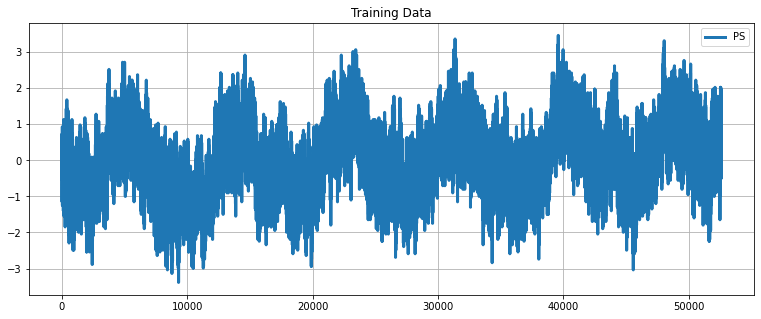

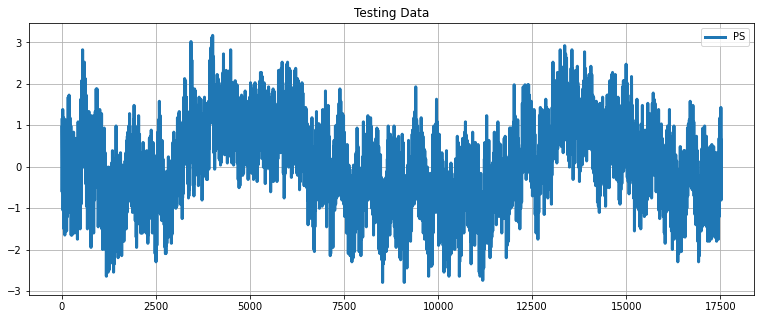

In [ ]:
# Define a data plotting function
def show_plot(data, title):
  plt.figure(figsize=(13, 5))
  plt.plot(data, linewidth=3)
  plt.title(title)
  plt.legend(["PS"])
  plt.grid()

show_plot(X_train, "Training Data")
show_plot(X_val, "Testing Data")

## Ridge Regression

In [ ]:
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import Ridge

# fit model to training data
ridge_model = Ridge(alpha=0.5)
ridge_model.fit(X_train, y_train)

# Evaluate of Validation Data
y_pred_1 = ridge_model.predict(X_val)
print("R Squared on Validation Set: ", ridge_model.score(X_val, y_val))
print("RMSE of Ridge Regressor: ", np.sqrt(mean_squared_error(y_val, y_pred_1)))

R Squared on Validation Set:  0.9325763493202884
RMSE of Ridge Regressor:  0.25798962888566485


In [ ]:
from math import sqrt

# Make Predictions on the entire dataset
y_pred = ridge_model.predict(X)
print("Model Prediction on entire dataset", y_pred)

# Inverse transform y and y_pred
# get the inverse transform of y (the next temp value)
original_y = scaler.inverse_transform(scaled_ps_data)[:, -1]
print("Original y", original_y)
# Manually calculate the Inverse transform the model prediction
unscaled_y_pred = (y_pred * sqrt(scaler.var_[-1])) + scaler.mean_[-1]
print("Unstandardized y_pred", unscaled_y_pred)

# Create a dataframe of the actual and predicted values for visualization
df_prediction = pd.DataFrame()
df_prediction["Actual"] = original_y
df_prediction["Prediction"] = unscaled_y_pred
df_prediction.set_index(dataset.index, inplace=True)
print(df_prediction.head(15))

# Function to plot interactive plots using Plotly Express
def interactive_plot2(df, title):
  fig = px.line(title=title)
  for i in df.columns:
    fig.add_scatter(x=df.index, y=df[i], name=i)
  fig.show()

# Plot the results
interactive_plot2(df_prediction, "Original vs. Predictions (Ridge)")

Model Prediction on entire dataset [ 0.03841921 -0.1532914  -0.34500201 ...  0.37391278  0.61355104
  0.61355104]
Original y [100.62 100.58 100.58 ... 100.78 100.78 100.75]
Unstandardized y_pred [100.65961858 100.62101195 100.58240533 ... 100.72718017 100.77543846
 100.77543846]
                     Actual  Prediction
Date                                   
2010-01-01 00:00:00  100.62  100.659619
2010-01-01 01:00:00  100.58  100.621012
2010-01-01 02:00:00  100.58  100.582405
2010-01-01 03:00:00  100.60  100.582405
2010-01-01 04:00:00  100.62  100.601709
2010-01-01 05:00:00  100.66  100.621012
2010-01-01 06:00:00  100.71  100.659619
2010-01-01 07:00:00  100.78  100.707877
2010-01-01 08:00:00  100.80  100.775438
2010-01-01 09:00:00  100.78  100.794742
2010-01-01 10:00:00  100.71  100.775438
2010-01-01 11:00:00  100.62  100.707877
2010-01-01 12:00:00  100.53  100.621012
2010-01-01 13:00:00  100.45  100.534147
2010-01-01 14:00:00  100.42  100.456934


## Lasso Regression

In [ ]:
from sklearn.linear_model import Lasso

# fit model to training data
lasso_model = Lasso(alpha=0.0005)
lasso_model.fit(X_train, y_train)

# Evaluate of Validation Data
y_pred_2 = lasso_model.predict(X_val)
print("R Squared Lasso Regressor: ", lasso_model.score(X_val, y_val))
print("RMSE of Lasso Regressor: ", np.sqrt(mean_squared_error(y_val, y_pred_2)))

R Squared Lasso Regressor:  0.9325754961190356
RMSE of Lasso Regressor:  0.25799126122369476


In [ ]:
# Make Predictions on the entire dataset
y_pred = lasso_model.predict(X)
print("Model Prediction on entire dataset", y_pred)

# Inverse transform y and y_pred
# get the inverse transform of y (the next temp value)
original_y = scaler.inverse_transform(scaled_ps_data)[:, -1]
print("Original y", original_y)
# Manually calculate the Inverse transform the model prediction
unscaled_y_pred = (y_pred * sqrt(scaler.var_[-1])) + scaler.mean_[-1]
print("Unstandardized y_pred", unscaled_y_pred)

# Create a dataframe of the actual and predicted values for visualization
df_prediction = pd.DataFrame()
df_prediction["Actual"] = original_y
df_prediction["Prediction"] = unscaled_y_pred
df_prediction.set_index(dataset.index, inplace=True)
print(df_prediction.head(15))

# Plot the results
interactive_plot2(df_prediction, "Original vs. Predictions (Lasso)")

Model Prediction on entire dataset [ 0.03839232 -0.15322113 -0.34483458 ...  0.37371585  0.61323266
  0.61323266]
Original y [100.62 100.58 100.58 ... 100.78 100.78 100.75]
Unstandardized y_pred [100.65961316 100.6210261  100.58243904 ... 100.72714052 100.77537434
 100.77537434]
                     Actual  Prediction
Date                                   
2010-01-01 00:00:00  100.62  100.659613
2010-01-01 01:00:00  100.58  100.621026
2010-01-01 02:00:00  100.58  100.582439
2010-01-01 03:00:00  100.60  100.582439
2010-01-01 04:00:00  100.62  100.601733
2010-01-01 05:00:00  100.66  100.621026
2010-01-01 06:00:00  100.71  100.659613
2010-01-01 07:00:00  100.78  100.707847
2010-01-01 08:00:00  100.80  100.775374
2010-01-01 09:00:00  100.78  100.794668
2010-01-01 10:00:00  100.71  100.775374
2010-01-01 11:00:00  100.62  100.707847
2010-01-01 12:00:00  100.53  100.621026
2010-01-01 13:00:00  100.45  100.534205
2010-01-01 14:00:00  100.42  100.457031


## Decision Tree Regression

In [ ]:
from sklearn.tree import DecisionTreeRegressor

# fit model to training data
dt_model = DecisionTreeRegressor(max_leaf_nodes=50,
                                 random_state=1)
dt_model.fit(X_train, y_train)

# Evaluate of Validation Data
y_pred_4 = dt_model.predict(X_val)
print("R Squared Decision Tree Regressor: ", dt_model.score(X_val, y_val))
print("RMSE of Decision Tree Regressor: ", np.sqrt(mean_squared_error(y_val, y_pred_4)))

R Squared Decision Tree Regressor:  0.9315315203310816
RMSE of Decision Tree Regressor:  0.25998090914130073


In [ ]:
# Make Predictions on the entire dataset
y_pred = dt_model.predict(X)
print("Model Prediction on entire dataset", y_pred)

# Inverse transform y and y_pred
# get the inverse transform of y (the next temp value)
original_y = scaler.inverse_transform(scaled_ps_data)[:, -1]
print("Original y", original_y)
# Manually calculate the Inverse transform the model prediction
unscaled_y_pred = (y_pred * sqrt(scaler.var_[-1])) + scaler.mean_[-1]
print("Unstandardized y_pred", unscaled_y_pred)

# Create a dataframe of the actual and predicted values for visualization
df_prediction = pd.DataFrame()
df_prediction["Actual"] = original_y
df_prediction["Prediction"] = unscaled_y_pred
df_prediction.set_index(dataset.index, inplace=True)
print(df_prediction.head(15))

# Plot the results
interactive_plot2(df_prediction, "Original vs. Predictions (Decision Tree)")

Model Prediction on entire dataset [ 0.05530894 -0.12984354 -0.36552735 ...  0.41137145  0.63853709
  0.63853709]
Original y [100.62 100.58 100.58 ... 100.78 100.78 100.75]
Unstandardized y_pred [100.66301983 100.62573388 100.57827194 ... 100.73472359 100.78047014
 100.78047014]
                     Actual  Prediction
Date                                   
2010-01-01 00:00:00  100.62  100.663020
2010-01-01 01:00:00  100.58  100.625734
2010-01-01 02:00:00  100.58  100.578272
2010-01-01 03:00:00  100.60  100.578272
2010-01-01 04:00:00  100.62  100.595630
2010-01-01 05:00:00  100.66  100.625734
2010-01-01 06:00:00  100.71  100.663020
2010-01-01 07:00:00  100.78  100.712621
2010-01-01 08:00:00  100.80  100.780470
2010-01-01 09:00:00  100.78  100.801943
2010-01-01 10:00:00  100.71  100.780470
2010-01-01 11:00:00  100.62  100.712621
2010-01-01 12:00:00  100.53  100.625734
2010-01-01 13:00:00  100.45  100.529704
2010-01-01 14:00:00  100.42  100.451319


## XGBoost Regressor

In [ ]:
from xgboost import XGBRegressor

# check for the best number of n_estimators
xgboost_model = XGBRegressor(n_estimators=1000, learning_rate=0.1, n_jobs=-1)
xgboost_model.fit(X_train, y_train,
                  early_stopping_rounds=5,
                  eval_set=[(X_val, y_val)],
                  verbose=False)


[18:12:49] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


XGBRegressor(n_estimators=1000, n_jobs=-1)

In [ ]:
# fit model to training data
from xgboost import XGBRegressor
xgboost_model = XGBRegressor(n_estimators=1000, learning_rate=0.1)
xgboost_model.fit(X_train, y_train)

# Evaluate of Validation Data
y_pred_5 = xgboost_model.predict(X_val)
print("R Squared XGBoost Regressor: ", xgboost_model.score(X_val, y_val))
print("RMSE of XGBoost Regressor: ", np.sqrt(mean_squared_error(y_val, y_pred_5)))

[18:13:10] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
R Squared XGBoost Regressor:  0.9325371351813645
RMSE of XGBoost Regressor:  0.25806464240439747


In [ ]:
# Make Predictions on the entire dataset
y_pred = xgboost_model.predict(X)
print("Model Prediction on entire dataset", y_pred)

# Inverse transform y and y_pred
# get the inverse transform of y (the next temp value)
original_y = scaler.inverse_transform(scaled_ps_data)[:, -1]
print("Original y", original_y)
# Manually calculate the Inverse transform the model prediction
unscaled_y_pred = (y_pred * sqrt(scaler.var_[-1])) + scaler.mean_[-1]
print("Unstandardized y_pred", unscaled_y_pred)

# Create a dataframe of the actual and predicted values for visualization
df_prediction = pd.DataFrame()
df_prediction["Actual"] = original_y
df_prediction["Prediction"] = unscaled_y_pred
df_prediction.set_index(dataset.index, inplace=True)
print(df_prediction.head(15))

# Plot the results
interactive_plot2(df_prediction, "Original vs. Predictions (XGBoost)")

Model Prediction on entire dataset [ 0.03280982 -0.15960974 -0.33778822 ...  0.39006227  0.6058828
  0.6058828 ]
Original y [100.62 100.58 100.58 ... 100.78 100.78 100.75]
Unstandardized y_pred [100.658485 100.619736 100.583855 ... 100.73043  100.77389  100.77389 ]
                     Actual  Prediction
Date                                   
2010-01-01 00:00:00  100.62  100.658485
2010-01-01 01:00:00  100.58  100.619736
2010-01-01 02:00:00  100.58  100.583855
2010-01-01 03:00:00  100.60  100.583855
2010-01-01 04:00:00  100.62  100.597755
2010-01-01 05:00:00  100.66  100.619736
2010-01-01 06:00:00  100.71  100.658485
2010-01-01 07:00:00  100.78  100.710739
2010-01-01 08:00:00  100.80  100.773888
2010-01-01 09:00:00  100.78  100.797516
2010-01-01 10:00:00  100.71  100.773888
2010-01-01 11:00:00  100.62  100.710739
2010-01-01 12:00:00  100.53  100.619736
2010-01-01 13:00:00  100.45  100.533890
2010-01-01 14:00:00  100.42  100.454445
